# Import functions and preprocessed datasets

In [14]:
from functions import *

In [15]:
psl = xr.open_dataset('data/psl_100_eq.nc')
laurentide_smb_mask = xr.open_dataset('data/laurentide_smb_100_eq.nc')
greenland_smb_mask = xr.open_dataset('data/greenland_smb_100_eq.nc')
eurasian_smb_mask = xr.open_dataset('data/eurasia_smb_100_eq.nc')

# PSL

## PSL set vars

In [16]:
print("PROCESSING PSL DATA AND CONVERTING TO 2D")
X_dimensional = psl["data"]
lat_length = int(psl["lat_length"])
long_length = int(psl["long_length"])
north_atlantic_ocean_psl = psl["original"]
psl_X_dimensional = X_dimensional.rename({"month": "data", "data": "month"}).T
print("______________")

PROCESSING PSL DATA AND CONVERTING TO 2D
______________


## PCA of PSL over North Atlantic

______________
DOING PCA
covariance matrix shape (6720, 6720)
we calculated the first  10  evals
______________
PLOTTING EVALS


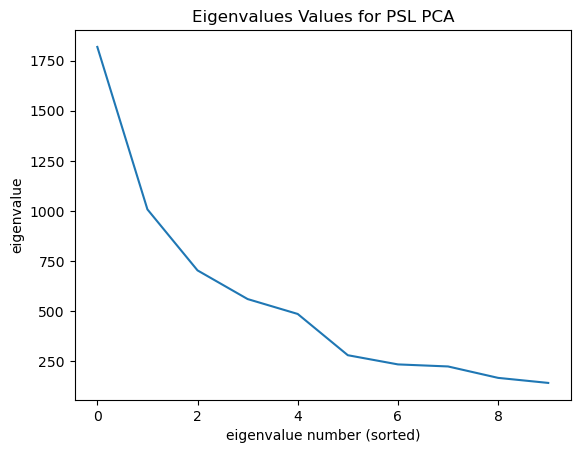

1 variance explained: 32.35%
2 variance explained: 17.93%
3 variance explained: 12.51%
4 variance explained: 9.96%
______________
PLOTTING TIME


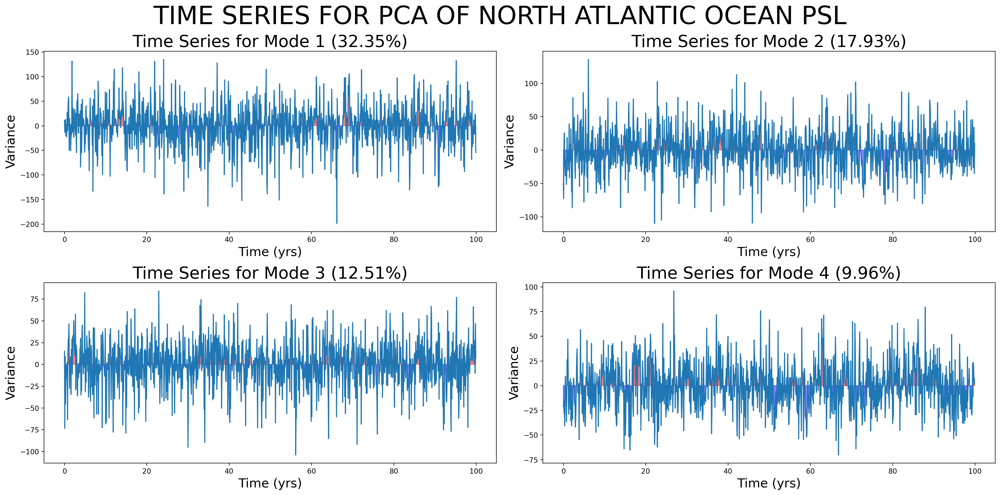

______________
PLOTTING PCs


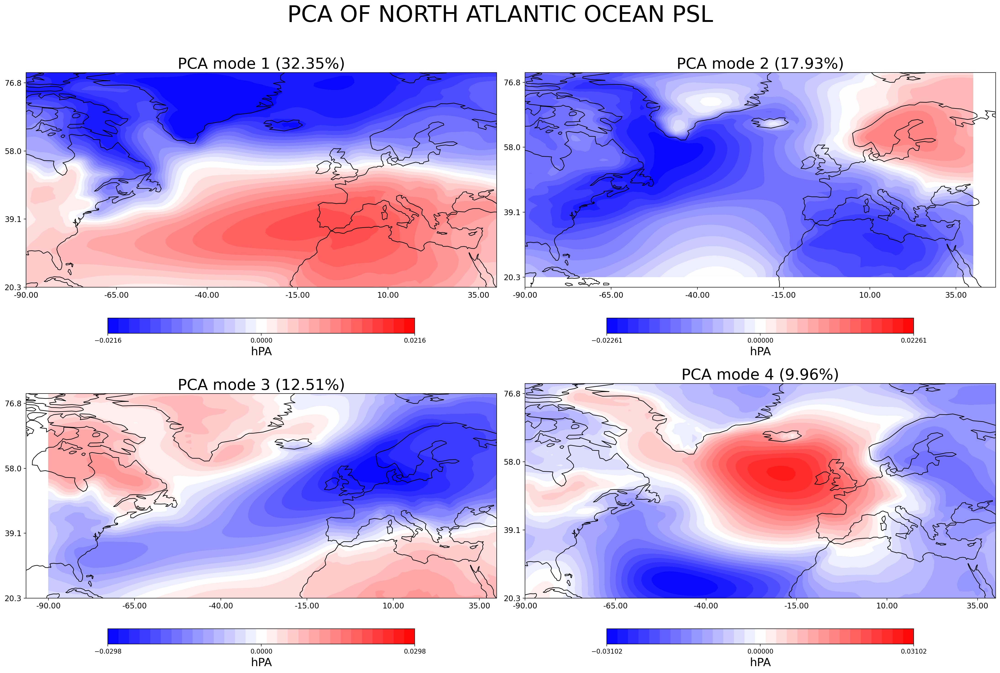

In [17]:
print("______________")
print("DOING PCA")
X = standardize(X_dimensional)
X = X.T
eigenvalues, V, X = pca(X, 10, False)
print("______________")
print("PLOTTING EVALS")
perc_psl = plot_eigen(eigenvalues, "PSL")
print("______________")
print("PLOTTING TIME")
plot_time_series(V, X, 4, "TIME SERIES FOR PCA OF NORTH ATLANTIC OCEAN PSL", perc_psl)
print("______________")
print("PLOTTING PCs")
PCs_reshaped = V.reshape(lat_length,long_length, 10)
data_psl ={
    'reshaped_pca': PCs_reshaped,
    'original': north_atlantic_ocean_psl,
    'label': "hPA",
    'shift': 0,
    'l_override': {},
    'perc': perc_psl
}

plot_pcs(data_psl, 4, "PCA OF NORTH ATLANTIC OCEAN PSL")

# Laurentide SMB

## Laurentide SMB Set Vars

In [18]:
print("PROCESSING SMB DATA AND CONVERTING TO 2D")
smb_X_dimensional = laurentide_smb_mask["data"]
smb_longs = laurentide_smb_mask["long_pos"]
smb_lats = laurentide_smb_mask["lat_pos"]
smb_long_length = int(laurentide_smb_mask["long_length"])
smb_lat_length = int(laurentide_smb_mask["lat_length"])
smb_processed = laurentide_smb_mask["original"]
print("______________")


PROCESSING SMB DATA AND CONVERTING TO 2D
______________


## PCA of Laurentide

DOING PCA
covariance matrix shape (1886, 1886)
we calculated the first  10  evals
______________
PLOTTING EVALS


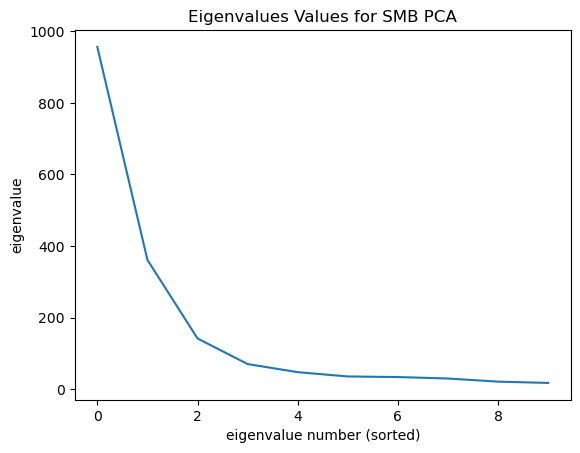

1 variance explained: 55.71%
2 variance explained: 21.06%
3 variance explained: 8.26%
4 variance explained: 4.1%
______________
PLOTTING TIME


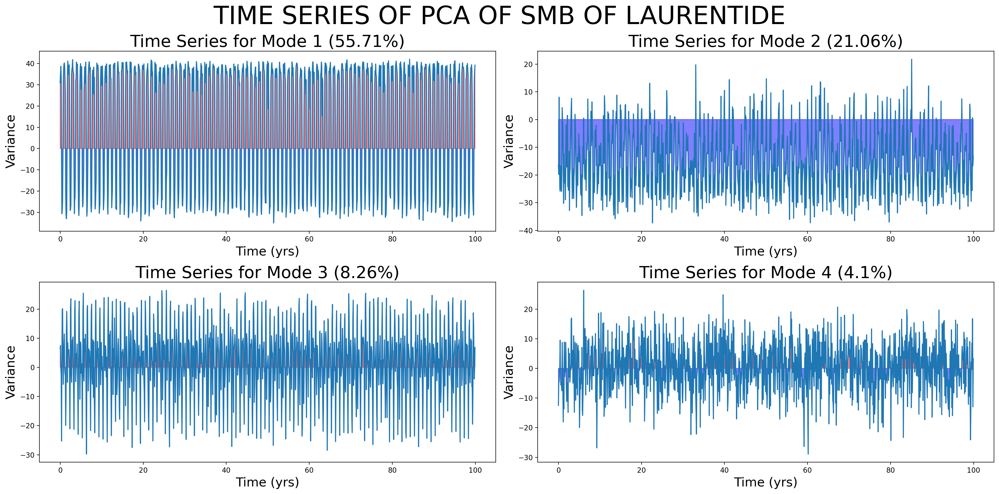

______________
PLOTTING PCs


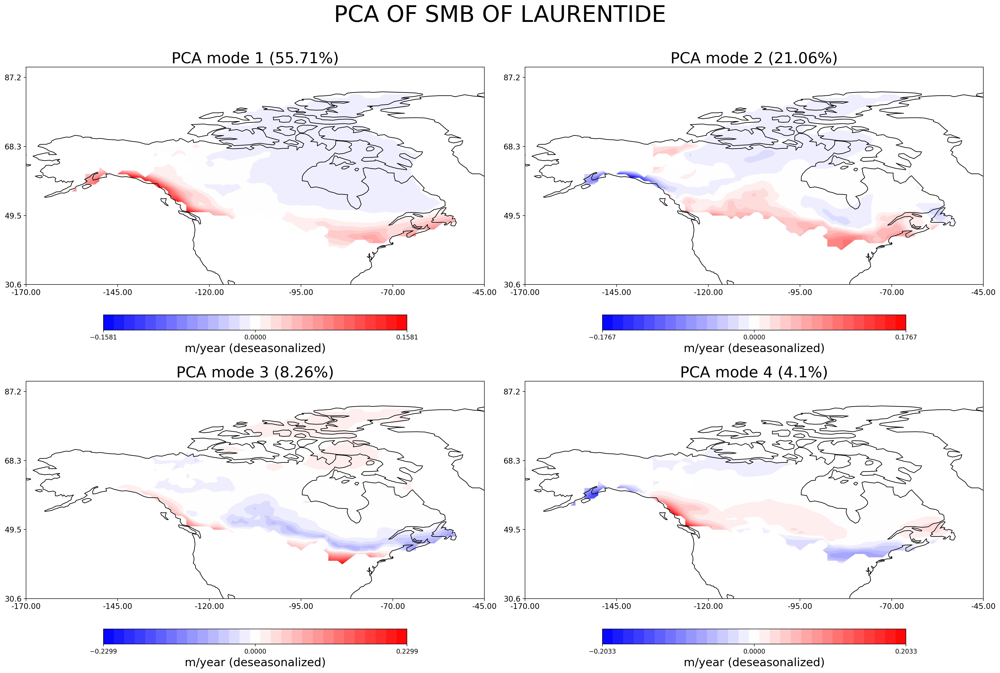

In [19]:

print("DOING PCA")
smb_eigenvalues, smb_V, smb_X = pca(smb_X_dimensional, 10)
print("______________")
print("PLOTTING EVALS")
perc_smb = plot_eigen(smb_eigenvalues, "SMB")
print("______________")
print("PLOTTING TIME")
plot_time_series(smb_V, smb_X, 4, "TIME SERIES OF PCA OF SMB OF LAURENTIDE", perc_smb)
print("______________")
print("PLOTTING PCs")
smb_PCAs = nans_2d_to_3d(smb_V, smb_long_length, smb_lat_length, smb_longs, smb_lats)
data_smb ={
    'reshaped_pca': smb_PCAs,
    'original': smb_processed,
    'label': "m/year (deseasonalized)",
    'shift': 360,
    'l_override': {
    },
    'perc': perc_smb
}

plot_pcs(data_smb, 4, "PCA OF SMB OF LAURENTIDE")

## Laurentide SMB and North Atlantic PSL MCA

______________
performing SVD
standardizing
creating covariance matrix
doing svd
______________
displaying covariance percentage


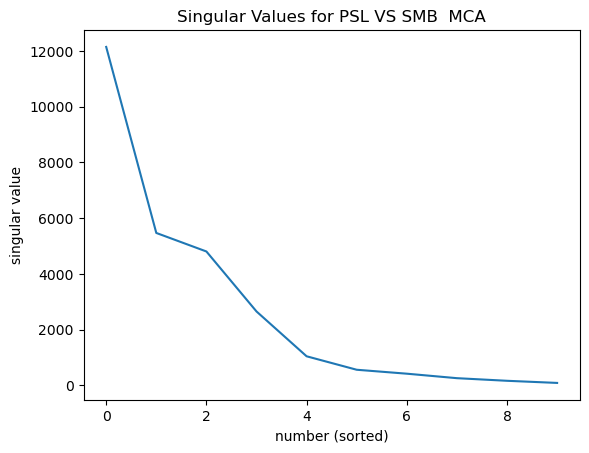

1 covariance explained: 43.97%
2 covariance explained: 19.81%
3 covariance explained: 17.4%
4 covariance explained: 9.61%
______________
graphing time series


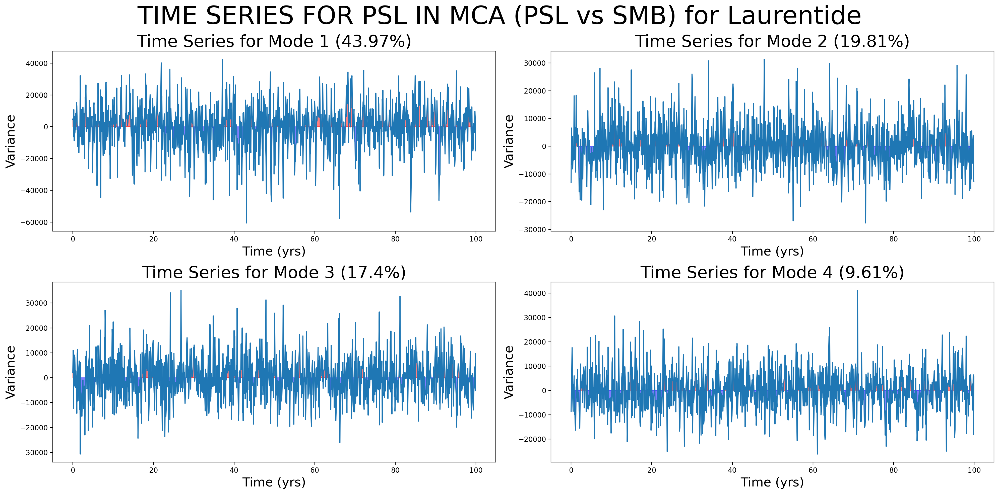

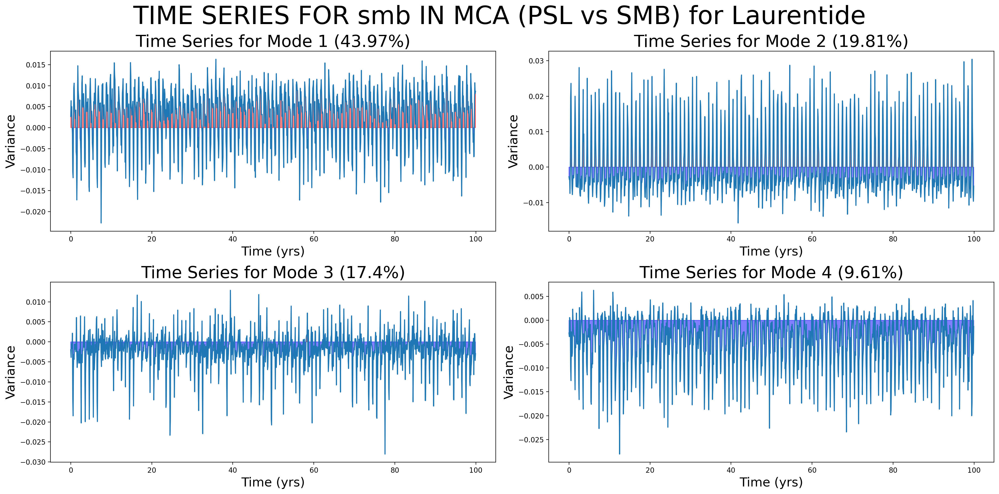

______________
reshaping to 3d
______________
graphing
understood data
made plots
plotting 0
plotting 1
plotting 2
plotting 3
accessorizing


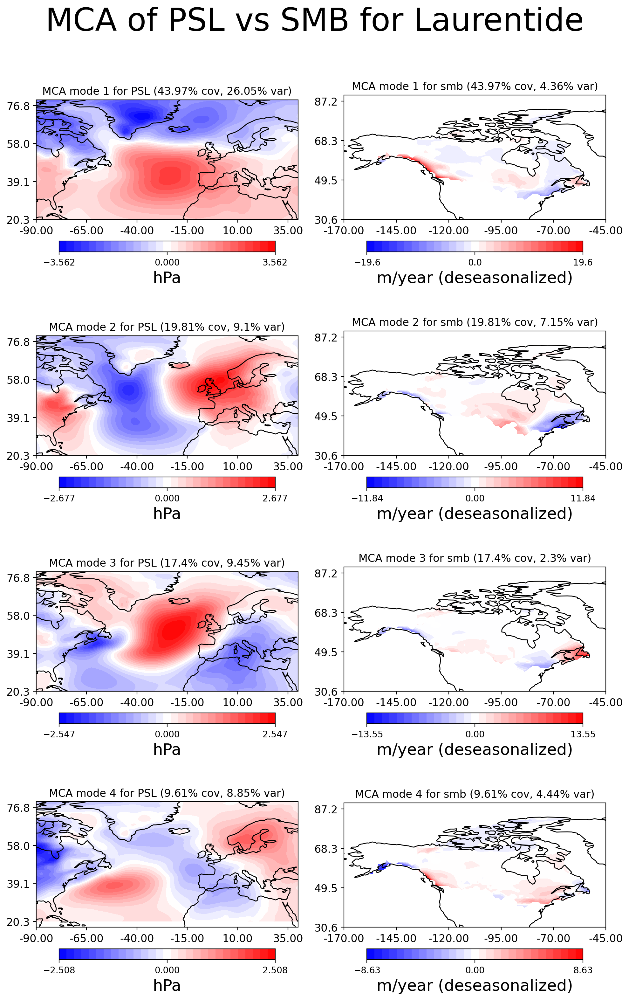

In [20]:
print("______________")
print("performing SVD")
psl_smb_U, psl_smb_S, psl_smb_V_T = svd(psl_X_dimensional, smb_X_dimensional, 10)

print("______________")
print("displaying covariance percentage")
cov_1 = plot_cov(psl_smb_S, "PSL VS SMB ")
x_var, y_var = mca_variance_explained(psl_X_dimensional, smb_X_dimensional, psl_smb_U, psl_smb_V_T, 4)

print("______________")
print("graphing time series")
plot_time_series(psl_smb_U, psl_X_dimensional, 4, "TIME SERIES FOR PSL IN MCA (PSL vs SMB) for Laurentide", cov_1)
plot_time_series(psl_smb_V_T.T, smb_X_dimensional, 4, "TIME SERIES FOR smb IN MCA (PSL vs SMB) for Laurentide", cov_1)

print("______________")
print("reshaping to 3d")
psl_U_reshaped = psl_smb_U.reshape(lat_length,long_length, 10)
smb_V_reshaped = nans_2d_to_3d(psl_smb_V_T.T, smb_long_length, smb_lat_length, smb_longs, smb_lats)

print("______________")
print("graphing")

data_mca1_1 ={
    'reshaped_mca': psl_U_reshaped,
    'original': north_atlantic_ocean_psl,
    'label': "hPa",
    'subtitle': "PSL",
    'shift': 0,
    'sigma':  psl_smb_S,
    'l_override': {}
}

data_mca1_2 ={
    'reshaped_mca': smb_V_reshaped,
    'original': smb_processed,
    'label': "m/year (deseasonalized)",
    'subtitle': "smb",
    'shift': 360,
    'sigma': psl_smb_S,
    'l_override': {
    }

}

plot_mca(data_mca1_1, data_mca1_2, 4, "MCA of PSL vs SMB for Laurentide", cov_1, x_var, y_var)

# Eurasian SMB

## Eurasian SMB Set Vars 

In [21]:
print("______________")
print("PROCESSING SMB DATA AND CONVERTING TO 2D")
smb_X_dimensional = eurasian_smb_mask["data"]
smb_longs = eurasian_smb_mask["long_pos"]
smb_lats = eurasian_smb_mask["lat_pos"]
smb_long_length = int(eurasian_smb_mask["long_length"])
smb_lat_length = int(eurasian_smb_mask["lat_length"])
smb_processed = eurasian_smb_mask["original"]

______________
PROCESSING SMB DATA AND CONVERTING TO 2D


## Eurasian SMB PCA

DOING PCA
covariance matrix shape (981, 981)
we calculated the first  10  evals
______________
PLOTTING EVALS


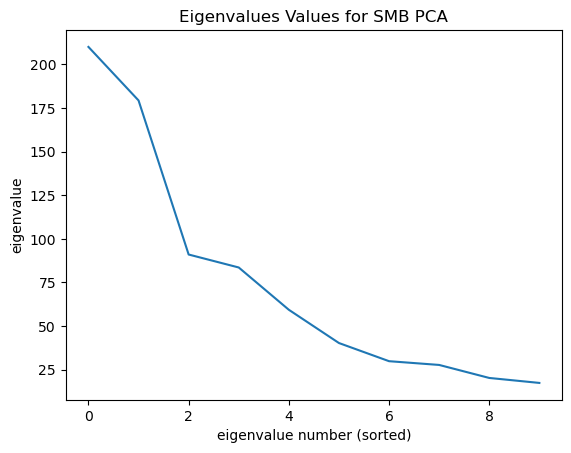

1 variance explained: 27.69%
2 variance explained: 23.64%
3 variance explained: 12.0%
4 variance explained: 11.02%
______________
PLOTTING TIME


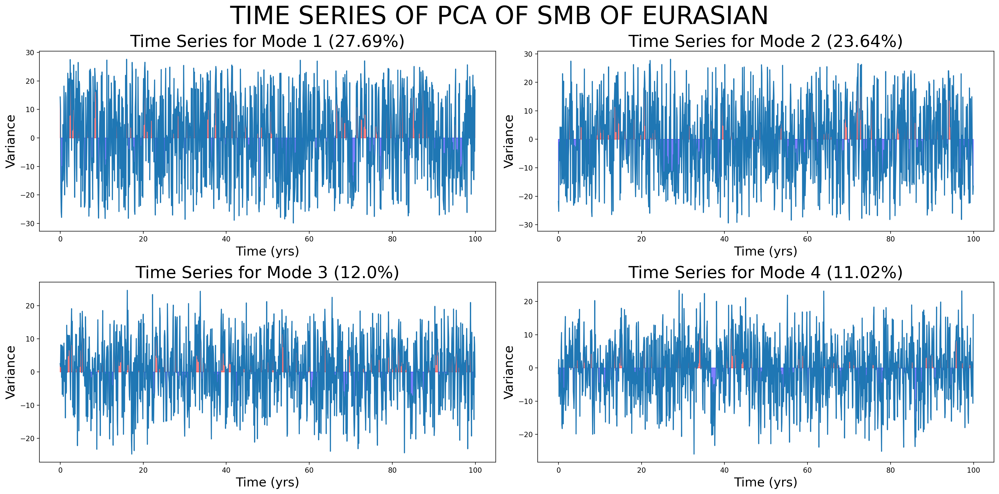

______________
PLOTTING PCs


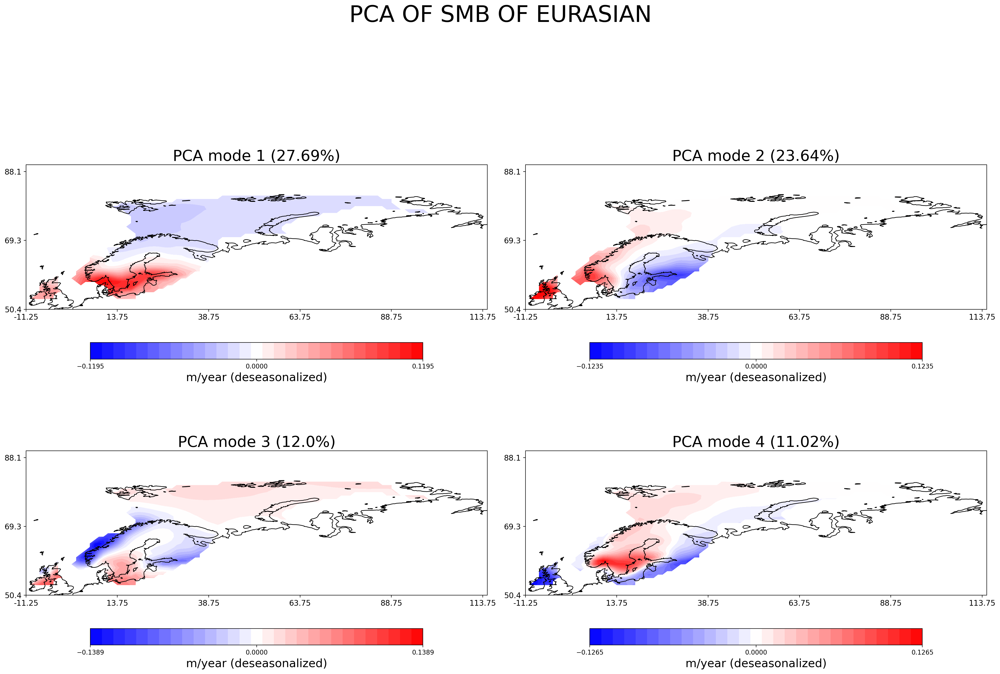

In [22]:
print("DOING PCA")
smb_eigenvalues, smb_V, smb_X = pca(smb_X_dimensional, 10)
print("______________")
print("PLOTTING EVALS")
perc_smb = plot_eigen(smb_eigenvalues, "SMB")
print("______________")
print("PLOTTING TIME")
plot_time_series(smb_V, smb_X, 4, "TIME SERIES OF PCA OF SMB OF EURASIAN", perc_smb)
print("______________")
print("PLOTTING PCs")
smb_PCAs = nans_2d_to_3d(smb_V, smb_long_length, smb_lat_length, smb_longs, smb_lats)
data_smb ={
    'reshaped_pca': smb_PCAs,
    'original': smb_processed,
    'label': "m/year (deseasonalized)",
    'shift': 0,
    'l_override': {
    },
    'perc': perc_smb
}

plot_pcs(data_smb, 4, "PCA OF SMB OF EURASIAN")

## Eurasian SMB and North Atlantic PSL MCA

______________
performing SVD
standardizing
creating covariance matrix
doing svd
______________
displaying covariance percentage


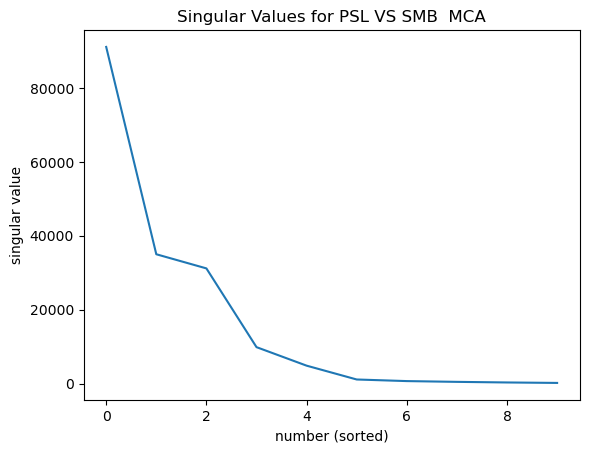

1 covariance explained: 52.17%
2 covariance explained: 20.04%
3 covariance explained: 17.85%
4 covariance explained: 5.64%
______________
graphing time series


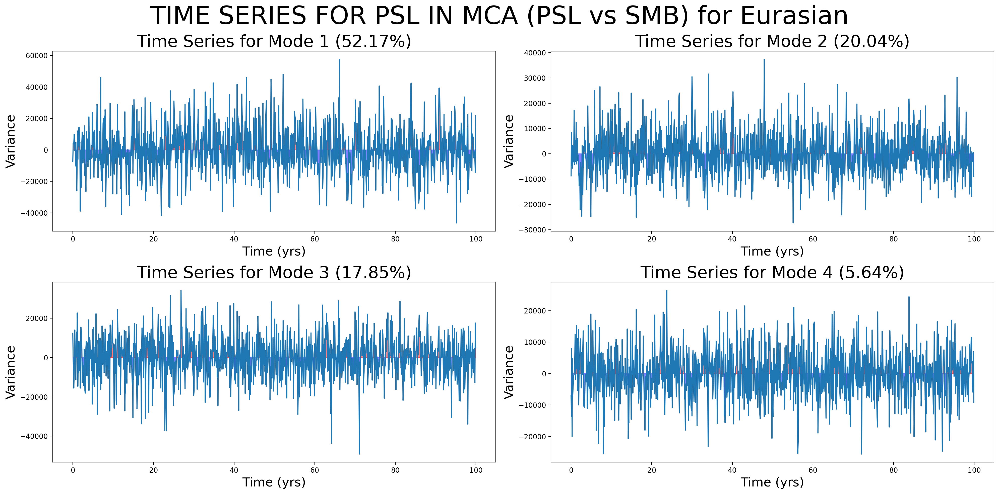

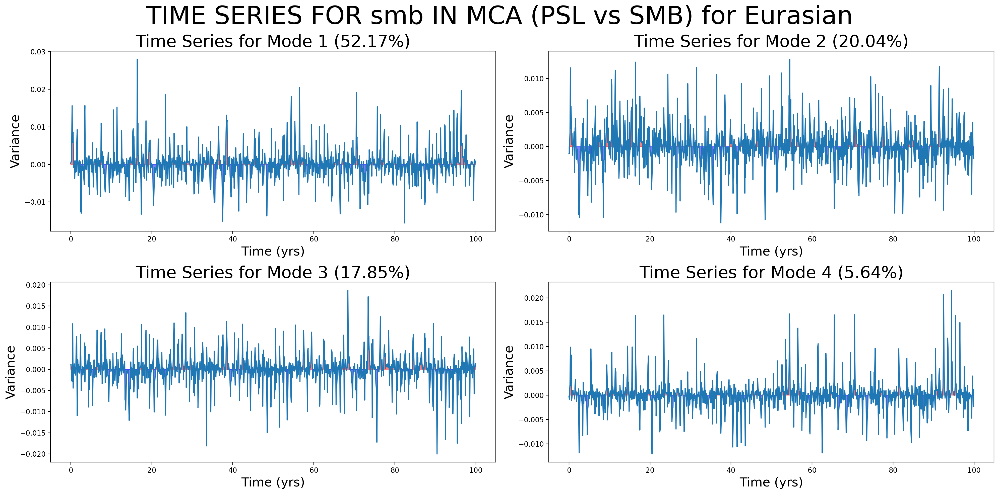

______________
reshaping to 3d
______________
graphing
understood data
made plots
plotting 0
plotting 1
plotting 2
plotting 3
accessorizing


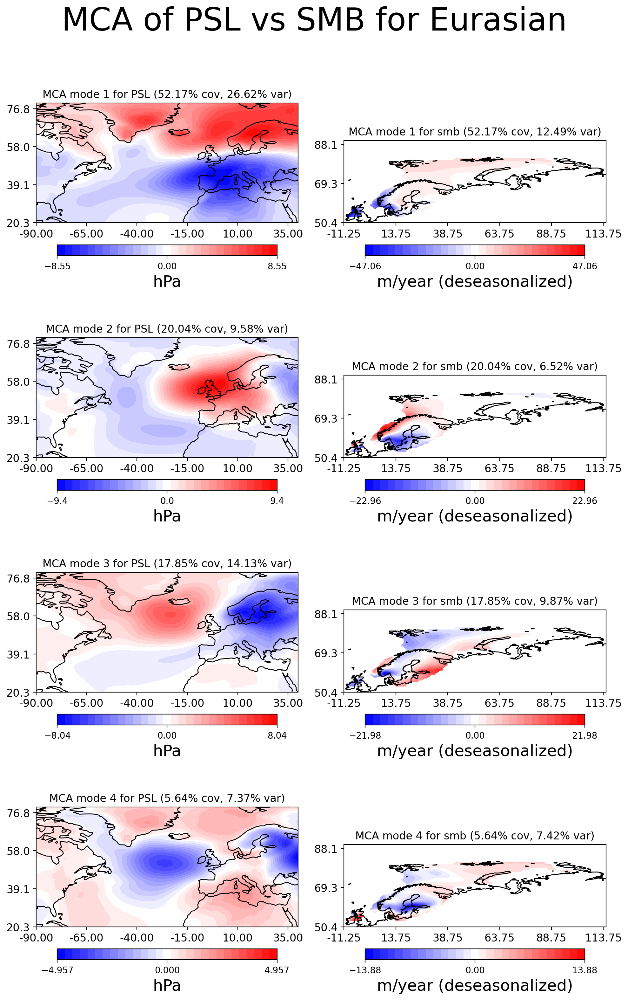

In [23]:
print("______________")
print("performing SVD")
psl_smb_U, psl_smb_S, psl_smb_V_T = svd(psl_X_dimensional, smb_X_dimensional, 10)

print("______________")
print("displaying covariance percentage")
cov_1 = plot_cov(psl_smb_S, "PSL VS SMB ")
x_var, y_var = mca_variance_explained(psl_X_dimensional, smb_X_dimensional, psl_smb_U, psl_smb_V_T, 4)

print("______________")
print("graphing time series")
plot_time_series(psl_smb_U, psl_X_dimensional, 4, "TIME SERIES FOR PSL IN MCA (PSL vs SMB) for Eurasian", cov_1)
plot_time_series(psl_smb_V_T.T, smb_X_dimensional, 4, "TIME SERIES FOR smb IN MCA (PSL vs SMB) for Eurasian", cov_1)

print("______________")
print("reshaping to 3d")
psl_U_reshaped = psl_smb_U.reshape(lat_length,long_length, 10)
smb_V_reshaped = nans_2d_to_3d(psl_smb_V_T.T, smb_long_length, smb_lat_length, smb_longs, smb_lats)

print("______________")
print("graphing")

data_mca1_1 ={
    'reshaped_mca': psl_U_reshaped,
    'original': north_atlantic_ocean_psl,
    'label': "hPa",
    'subtitle': "PSL",
    'shift': 0,
    'sigma':  psl_smb_S,
    'l_override': {}
}

data_mca1_2 ={
    'reshaped_mca': smb_V_reshaped,
    'original': smb_processed,
    'label': "m/year (deseasonalized)",
    'subtitle': "smb",
    'shift': 0,
    'sigma': psl_smb_S,
    'l_override': {
    }

}

plot_mca(data_mca1_1, data_mca1_2, 4, "MCA of PSL vs SMB for Eurasian", cov_1, x_var, y_var)

# Greenland

## Storage

In [24]:
print("______________")
print("PROCESSING SMB DATA AND CONVERTING TO 2D")
smb_X_dimensional = greenland_smb_mask["data"]
smb_longs = greenland_smb_mask["long_pos"]
smb_lats = greenland_smb_mask["lat_pos"]
smb_long_length = int(greenland_smb_mask["long_length"])
smb_lat_length = int(greenland_smb_mask["lat_length"])
smb_processed = greenland_smb_mask["original"]

______________
PROCESSING SMB DATA AND CONVERTING TO 2D


## PCA of SMB for Greenland

DOING PCA
covariance matrix shape (561, 561)
we calculated the first  10  evals
______________
PLOTTING EVALS


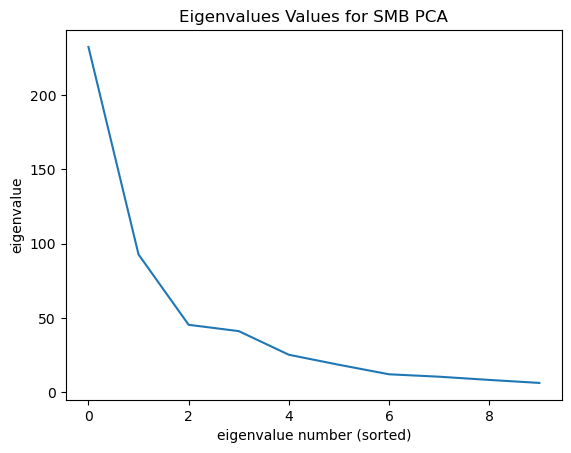

1 variance explained: 47.32%
2 variance explained: 18.85%
3 variance explained: 9.21%
4 variance explained: 8.35%
______________
PLOTTING TIME


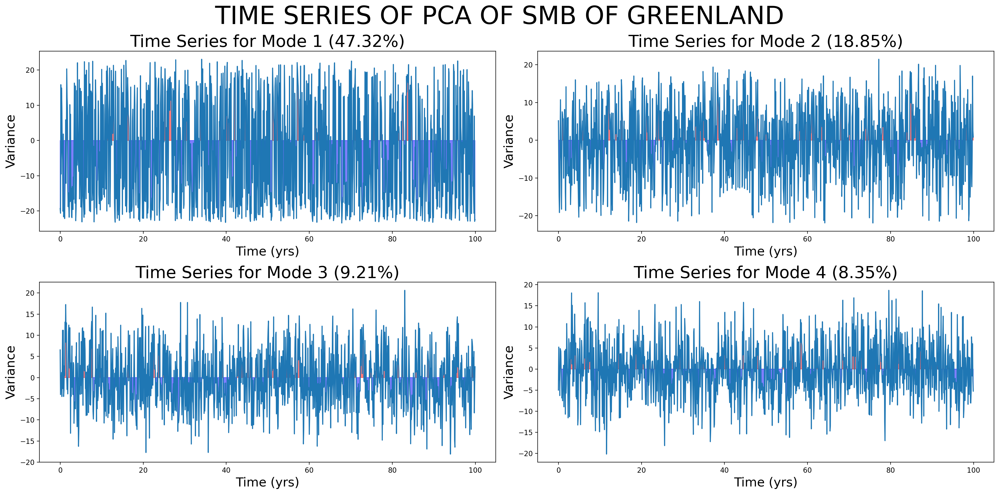

______________
PLOTTING PCs


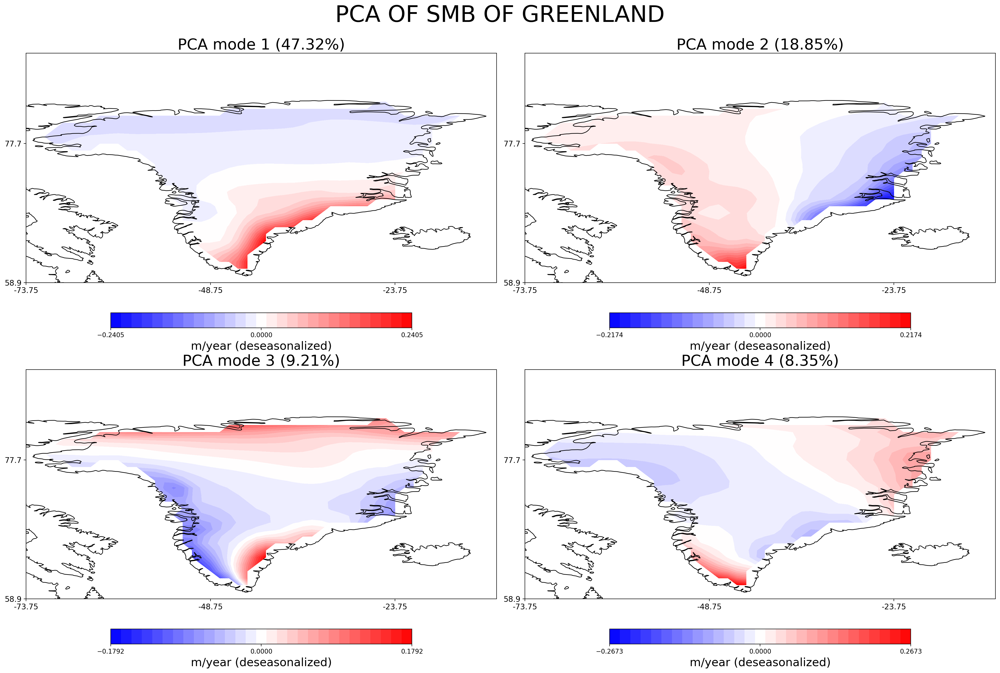

In [25]:

print("DOING PCA")
smb_eigenvalues, smb_V, smb_X = pca(smb_X_dimensional, 10)
print("______________")
print("PLOTTING EVALS")
perc_smb = plot_eigen(smb_eigenvalues, "SMB")
print("______________")
print("PLOTTING TIME")
plot_time_series(smb_V, smb_X, 4, "TIME SERIES OF PCA OF SMB OF GREENLAND", perc_smb)
print("______________")
print("PLOTTING PCs")
smb_PCAs = nans_2d_to_3d(smb_V, smb_long_length, smb_lat_length, smb_longs, smb_lats)
data_smb ={
    'reshaped_pca': smb_PCAs,
    'original': smb_processed,
    'label': "m/year (deseasonalized)",
    'shift': 360,
    'l_override': {
    },
    'perc': perc_smb
}

plot_pcs(data_smb, 4, "PCA OF SMB OF GREENLAND")

## Greenland SMB and North Atlantic PSL MCA

______________
performing SVD
standardizing
creating covariance matrix
doing svd
______________
displaying covariance percentage


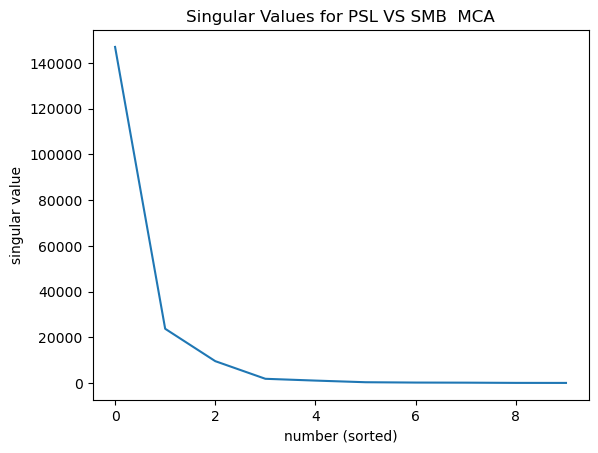

1 covariance explained: 79.8%
2 covariance explained: 12.89%
3 covariance explained: 5.2%
4 covariance explained: 1.02%
______________
graphing time series


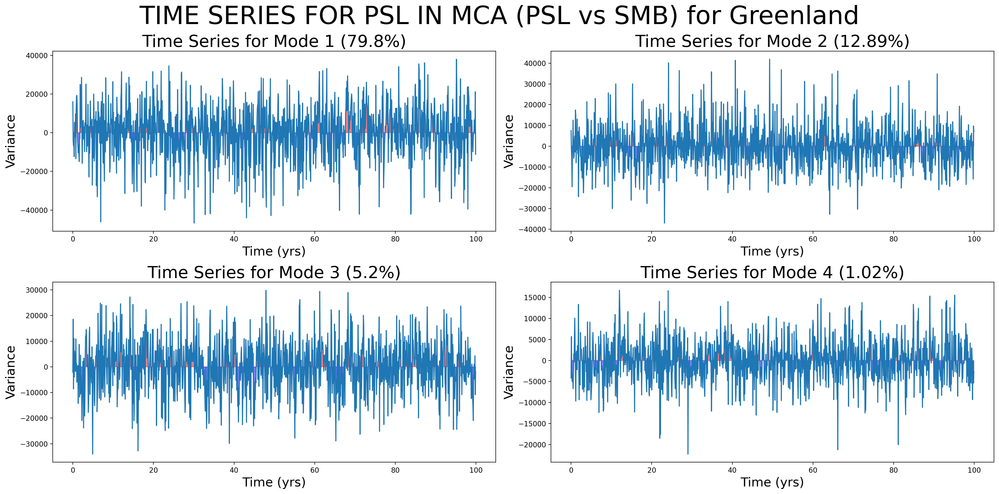

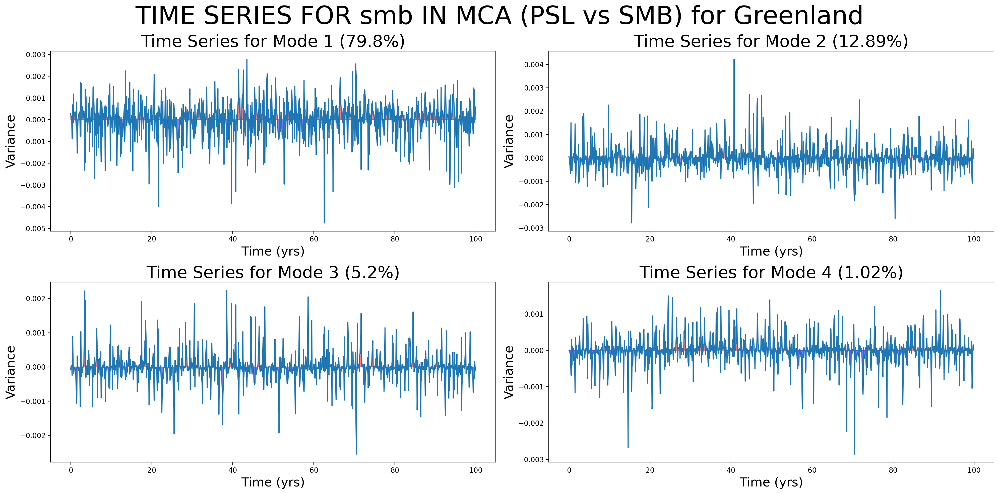

______________
reshaping to 3d
______________
graphing
understood data
made plots
plotting 0
plotting 1
plotting 2
plotting 3
accessorizing


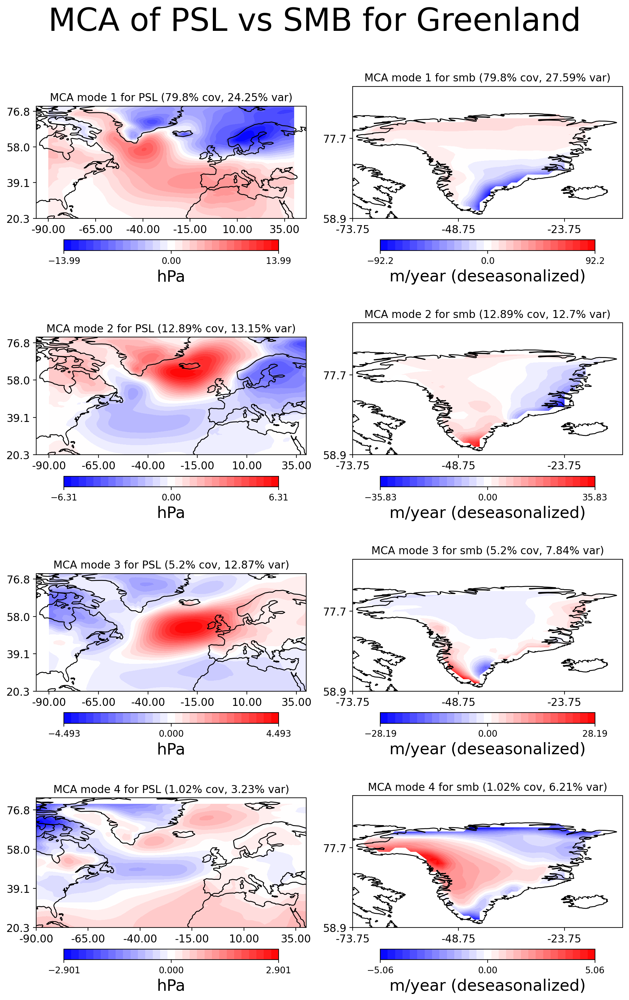

In [26]:
print("______________")
print("performing SVD")
psl_smb_U, psl_smb_S, psl_smb_V_T = svd(psl_X_dimensional, smb_X_dimensional, 10)

print("______________")
print("displaying covariance percentage")
cov_1 = plot_cov(psl_smb_S, "PSL VS SMB ")
x_var, y_var = mca_variance_explained(psl_X_dimensional, smb_X_dimensional, psl_smb_U, psl_smb_V_T, 4)

print("______________")
print("graphing time series")
plot_time_series(psl_smb_U, psl_X_dimensional, 4, "TIME SERIES FOR PSL IN MCA (PSL vs SMB) for Greenland", cov_1)
plot_time_series(psl_smb_V_T.T, smb_X_dimensional, 4, "TIME SERIES FOR smb IN MCA (PSL vs SMB) for Greenland", cov_1)

print("______________")
print("reshaping to 3d")
psl_U_reshaped = psl_smb_U.reshape(lat_length,long_length, 10)
smb_V_reshaped = nans_2d_to_3d(psl_smb_V_T.T, smb_long_length, smb_lat_length, smb_longs, smb_lats)

print("______________")
print("graphing")

data_mca1_1 ={
    'reshaped_mca': psl_U_reshaped,
    'original': north_atlantic_ocean_psl,
    'label': "hPa",
    'subtitle': "PSL",
    'shift': 0,
    'sigma':  psl_smb_S,
    'l_override': {}
}

data_mca1_2 ={
    'reshaped_mca': smb_V_reshaped,
    'original': smb_processed,
    'label': "m/year (deseasonalized)",
    'subtitle': "smb",
    'shift': 360,
    'sigma': psl_smb_S,
    'l_override': {
    }

}

plot_mca(data_mca1_1, data_mca1_2, 4, "MCA of PSL vs SMB for Greenland", cov_1, x_var, y_var)